```
!/mnt2/kireev/pipenv_envs/pytorch-lifestream-bcSZKFyz/bin/kaggle datasets download -d nphantawee/pump-sensor-data

ls -l

!unzip pump-sensor-data.zip
```

In [1]:
import sys

In [2]:
sys.path.append('../../')

In [3]:
import numpy as np

In [4]:
import pandas as pd

In [5]:
import matplotlib.pyplot as plt

In [6]:
from tqdm.auto import tqdm

In [7]:
df_data = pd.read_csv('sensor.csv', index_col=0)

In [8]:
df_data['timestamp'] = pd.to_datetime(df_data['timestamp'])

In [9]:
df_data = df_data.set_index('timestamp').sort_index()

In [10]:
y_data = df_data['machine_status']

In [11]:
x_data = df_data.drop(columns='machine_status')

In [12]:
x_data.isna().mean().sort_values()

sensor_23    0.000073
sensor_28    0.000073
sensor_27    0.000073
sensor_34    0.000073
sensor_24    0.000073
sensor_35    0.000073
sensor_36    0.000073
sensor_21    0.000073
sensor_20    0.000073
sensor_19    0.000073
sensor_37    0.000073
sensor_33    0.000073
sensor_31    0.000073
sensor_13    0.000086
sensor_11    0.000086
sensor_02    0.000086
sensor_10    0.000086
sensor_03    0.000086
sensor_12    0.000086
sensor_04    0.000086
sensor_05    0.000086
sensor_26    0.000091
sensor_14    0.000095
sensor_45    0.000123
sensor_43    0.000123
sensor_42    0.000123
sensor_41    0.000123
sensor_38    0.000123
sensor_39    0.000123
sensor_44    0.000123
sensor_40    0.000123
sensor_47    0.000123
sensor_48    0.000123
sensor_46    0.000123
sensor_49    0.000123
sensor_16    0.000141
sensor_25    0.000163
sensor_22    0.000186
sensor_18    0.000209
sensor_17    0.000209
sensor_32    0.000309
sensor_29    0.000327
sensor_30    0.001185
sensor_01    0.001675
sensor_09    0.020856
sensor_06 

In [13]:
y_data.value_counts()

NORMAL        205836
RECOVERING     14477
BROKEN             7
Name: machine_status, dtype: int64

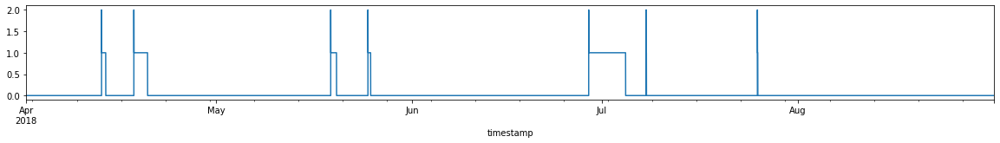

In [14]:
y_data.map({'NORMAL': 0, 'RECOVERING': 1, 'BROKEN': 2}).plot(figsize=(20, 2))
plt.show()

In [15]:
x_data = x_data.fillna(method='ffill').drop(columns='sensor_15')

In [16]:
x_data.index.max() - x_data.index.min()

Timedelta('152 days 23:59:00')

In [17]:
len(x_data), len(x_data) / 153

(220320, 1440.0)

In [18]:
print('Mean recovering time {:1f}'.format(y_data.eq('RECOVERING').sum() / y_data.eq('BROKEN').sum()))

Mean recovering time 2068.142857


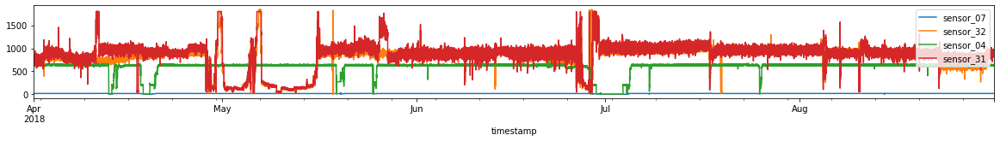

In [19]:
x_data.iloc[:, np.random.choice(x_data.shape[1], 4, replace=False)].plot(figsize=(20, 2))
plt.show()

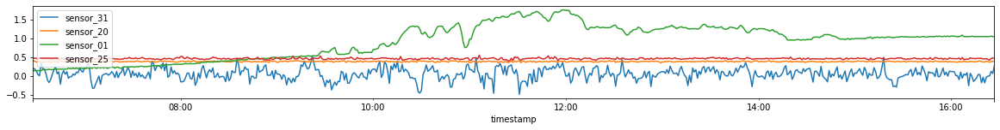

In [20]:
p = np.random.randint(0, 220320 - 120 * 5)
((x_data - x_data.mean()) / x_data.std()).clip(-5, 5) \
    .iloc[p : p + 120 * 5, np.random.choice(x_data.shape[1], 4, replace=False)].plot(figsize=(20, 2))
plt.show()

In [21]:
len(x_data) // 2 **10

215

In [22]:
from sklearn.manifold import TSNE

In [23]:
from sklearn.decomposition import PCA

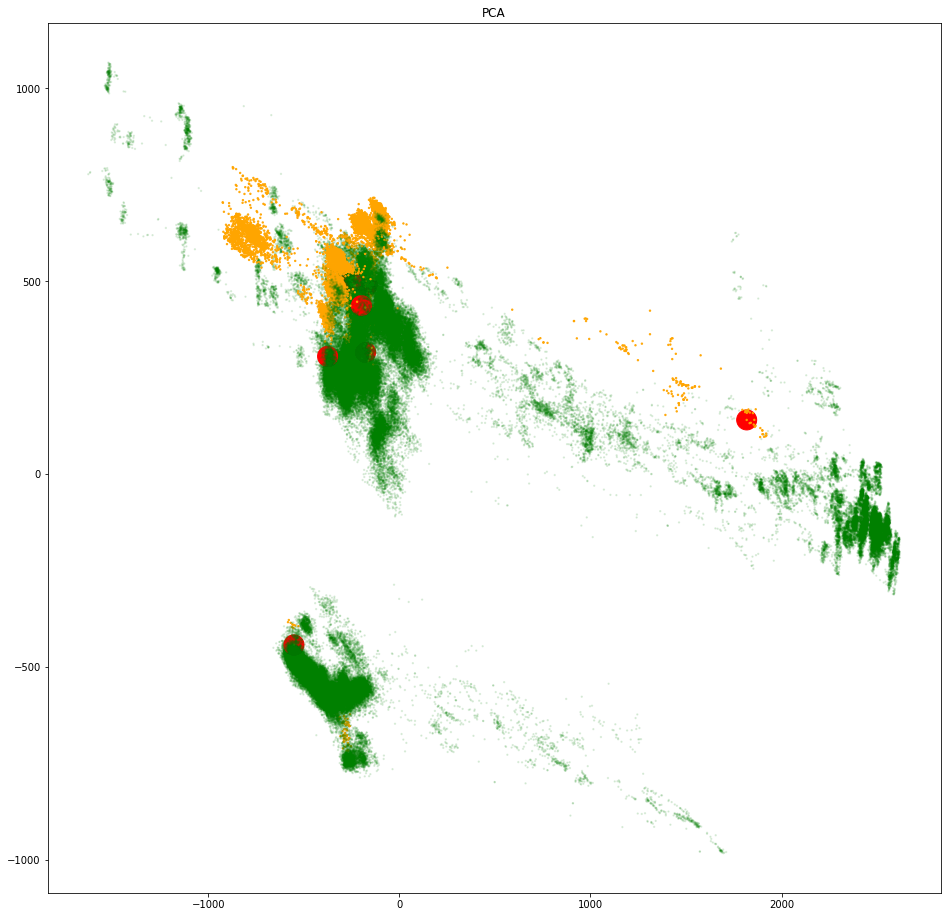

In [24]:
pca = PCA(n_components=2)
r_pca = pca.fit_transform(x_data.values)

plt.figure(figsize=(16, 16))
plt.scatter(
    r_pca[:, 0], r_pca[:, 1],
    c=y_data.map({'NORMAL': 'green', 'RECOVERING': 'orange', 'BROKEN': 'red'}).values,
    s=y_data.map({'NORMAL': 2, 'RECOVERING': 2, 'BROKEN': 400}).values,
    alpha=y_data.map({'NORMAL': 0.1, 'RECOVERING': 0.9, 'BROKEN': 1.0}).values,
)
plt.title('PCA')
plt.show()

In [25]:
# !rm -r lightning_logs/

In [26]:
import torch
import pytorch_lightning as pl

In [27]:
import dltranz.lightning_modules.stream_encoder as se

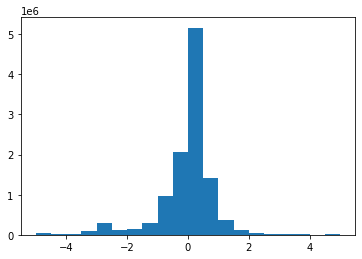

In [28]:
plt.hist(((x_data - x_data.mean()) / x_data.std()).values.flatten().clip(-5, 5), bins=20)
plt.show()

In [29]:
class TSwapChannels(torch.nn.Module):
    def forward(self, x):
        return x.transpose(1, 2).contiguous()

In [30]:
predict_w = 0.8 ** np.arange(-2, 8)
predict_w = predict_w / predict_w.sum()
predict_w.round(3)

array([0.224, 0.179, 0.143, 0.115, 0.092, 0.073, 0.059, 0.047, 0.038,
       0.03 ])

In [31]:
# predict_w = np.ones(10)
# predict_w = predict_w / predict_w.sum()
# predict_w.round(3)

In [32]:
stream_encoder = se.StreamEncoder(
    encoder_x2z=torch.nn.Sequential(
        se.TBatchNorm(x_data.shape[1]),
        se.ClipRange((-5, 5)),
        se.TDropout(0.0),
        TSwapChannels(),
        torch.nn.Conv1d(
            in_channels=x_data.shape[1], out_channels=16,
            kernel_size=12, stride=12, padding=0,
        ),
        torch.nn.Conv1d(
            in_channels=16, out_channels=16,
            kernel_size=5, stride=5, padding=0,
        ),
#         torch.nn.Conv1d(
#             in_channels=16, out_channels=16,
#             kernel_size=8, stride=8, padding=0,
#         ),
        TSwapChannels(),
    ),
    history_size=20, predict_range=np.arange(-2, 8), predict_w=predict_w,
    z_channels=16, c_channels=32,
    var_gamma_z=0.5, var_gamma_c=0.3,
    lr=0.0001, weight_decay=0.0001,
    step_size=5, gamma=0.9,
    cpc_w=0.1, cov_z_w=1.0, var_z_w=1.0, cov_c_w=1.0, var_c_w=1.0,
)

In [33]:
l3dt = se.Loader3DTensor(stream_encoder)
dl_train = l3dt.get_train_dataloader(torch.from_numpy(x_data.values).unsqueeze(0).float(), 128, 12, 1 * 12 * 5)
dl_valid = l3dt.get_valid_dataloader(torch.from_numpy(x_data.values).unsqueeze(0).float(), 512, 0)

In [34]:
print(len(dl_train), len(dl_valid))
print(next(iter(dl_train))[0].shape, next(iter(dl_valid))[0].shape)

1709 1
torch.Size([128, 1680, 51]) torch.Size([1, 220320, 51])


In [35]:
trainer = pl.Trainer(
    gpus=[3],
    max_epochs=50,
    log_every_n_steps=10,
    progress_bar_refresh_rate=50, weights_summary=None,
    logger=pl.loggers.TensorBoardLogger(
        save_dir='lightning_logs/',
        default_hp_metric=False,
    )
)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores


In [36]:
trainer.fit(stream_encoder, train_dataloader=dl_train, val_dataloaders=dl_valid)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1,2,3]


Validation sanity check: 0it [00:00, ?it/s]

/mnt2/kireev/pipenv_envs/pytorch-lifestream-bcSZKFyz/lib/python3.8/site-packages/pytorch_lightning/utilities/distributed.py:69: UserWarning: The dataloader, val dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 24 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  warnings.warn(*args, **kwargs)


RuntimeError: The size of tensor a (3653) must match the size of tensor b (3654) at non-singleton dimension 1

In [617]:
stream_encoder = se.StreamEncoder.load_from_checkpoint(
    'lightning_logs/default/version_17/checkpoints/epoch=45-step=78107.ckpt')

In [618]:
print(stream_encoder.hparams)

"c_channels":    32
"cov_c_w":       1.0
"cov_z_w":       0.5
"cpc_w":         0.2
"encoder_x2z":   Sequential(
  (0): TBatchNorm(51, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (1): ClipRange()
  (2): TDropout()
  (3): TSwapChannels()
  (4): Conv1d(51, 16, kernel_size=(12,), stride=(12,))
  (5): Conv1d(16, 16, kernel_size=(5,), stride=(5,))
  (6): TSwapChannels()
)
"gamma":         0.9
"history_size":  40
"lr":            0.0001
"predict_range": [0 1 2 3 4 5 6 7 8 9]
"predict_w":     [0.30872059 0.21610441 0.15127309 0.10589116 0.07412381 0.05188667
 0.03632067 0.02542447 0.01779713 0.01245799]
"step_size":     5
"var_c_w":       1.0
"var_gamma_c":   0.3
"var_gamma_z":   0.5
"var_z_w":       1.0
"weight_decay":  0.0001
"z_channels":    16


In [619]:
stream_encoder.eval()

StreamEncoder(
  (encoder_x2z): Sequential(
    (0): TBatchNorm(51, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (1): ClipRange()
    (2): TDropout()
    (3): TSwapChannels()
    (4): Conv1d(51, 16, kernel_size=(12,), stride=(12,))
    (5): Conv1d(16, 16, kernel_size=(5,), stride=(5,))
    (6): TSwapChannels()
  )
  (ar_rnn_z2c): GRU(16, 32, batch_first=True)
  (lin_predictors_c2p): ModuleList(
    (0): Linear(in_features=32, out_features=16, bias=True)
    (1): Linear(in_features=32, out_features=16, bias=True)
    (2): Linear(in_features=32, out_features=16, bias=True)
    (3): Linear(in_features=32, out_features=16, bias=True)
    (4): Linear(in_features=32, out_features=16, bias=True)
    (5): Linear(in_features=32, out_features=16, bias=True)
    (6): Linear(in_features=32, out_features=16, bias=True)
    (7): Linear(in_features=32, out_features=16, bias=True)
    (8): Linear(in_features=32, out_features=16, bias=True)
    (9): Linear(in_features=32, out_fea

In [757]:
dl_inference = torch.utils.data.DataLoader(
    torch.utils.data.TensorDataset(torch.from_numpy(x_data.values).unsqueeze(0).float()),
    batch_size=512,
    num_workers=0,
)

with torch.no_grad():
    x = next(iter(dl_inference))[0]
    z, c = stream_encoder(x)
    p = {i: l(c) for i, l in zip(stream_encoder.hparams.predict_range, stream_encoder.lin_predictors_c2p)}

In [758]:
x.shape, z.shape, c.shape, {k: v.shape for k, v in p.items()}

(torch.Size([1, 220320, 51]),
 torch.Size([1, 3672, 16]),
 torch.Size([1, 3672, 32]),
 {0: torch.Size([1, 3672, 16]),
  1: torch.Size([1, 3672, 16]),
  2: torch.Size([1, 3672, 16]),
  3: torch.Size([1, 3672, 16]),
  4: torch.Size([1, 3672, 16]),
  5: torch.Size([1, 3672, 16]),
  6: torch.Size([1, 3672, 16]),
  7: torch.Size([1, 3672, 16]),
  8: torch.Size([1, 3672, 16]),
  9: torch.Size([1, 3672, 16])})

In [759]:
x_reduced = x.view(1, -1, 12 * 5 * 1, 51).mean(dim=2)
y_data_reduced = pd.Series(np.where(
    (y_data.values.reshape(-1, 12 * 5 * 1) == 'BROKEN').sum(axis=1), 'BROKEN',
    np.where(
        (y_data.values.reshape(-1, 12 * 5 * 1) == 'RECOVERING').sum(axis=1), 'RECOVERING',
        'NORMAL',
    ),  
))

In [760]:
x_reduced.shape, y_data_reduced.shape

(torch.Size([1, 3672, 51]), (3672,))

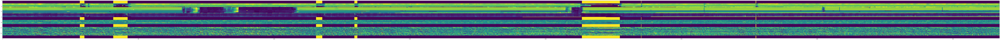

In [766]:
_, axs = plt.subplots(1, 1, figsize=(240, 3 * 5))

t = x_reduced
t = t - t.min(dim=1, keepdim=True).values
t = t / t.max(dim=1, keepdim=True).values
tx = t
t = z
t = t - t.min(dim=1, keepdim=True).values
t = t / t.max(dim=1, keepdim=True).values
tz = t
t = c
t = t - t.min(dim=1, keepdim=True).values
t = t / t.max(dim=1, keepdim=True).values
tc = t

axs.imshow(np.concatenate([
    (y_data_reduced != 'NORMAL').values.astype(float).reshape(1, -1).repeat(10, 0),
    tx[0].numpy().T,
    (y_data_reduced != 'NORMAL').values.astype(float).reshape(1, -1).repeat(10, 0),
    tz[0].numpy().T,
    (y_data_reduced != 'NORMAL').values.astype(float).reshape(1, -1).repeat(10, 0),
    tc[0].numpy().T,
    (y_data_reduced != 'NORMAL').values.astype(float).reshape(1, -1).repeat(10, 0),
], axis=0))
plt.show()

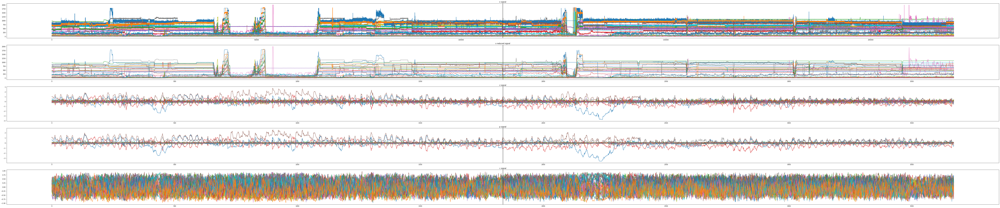

In [655]:
pred_horizon = 1
_, axs = plt.subplots(5, 1, figsize=(120, 5 * 5))
axs[0].plot(x[0].detach().numpy())
axs[0].set_title('x signal')
axs[0].axvline(x.size(1) // 2, color='black')
axs[1].plot(x_reduced[0].detach().numpy())
axs[1].set_title('x reduced signal')
axs[1].axvline(x_reduced.size(1) // 2, color='black')
axs[2].plot(z[0].detach().numpy())
axs[2].set_title('z signal')
axs[2].axvline(z.size(1) // 2, color='black')
axs[3].plot(p[pred_horizon - 1][0].detach().numpy())
axs[3].set_title('p signal')
axs[3].axvline(p[pred_horizon - 1].size(1) // 2, color='black')
axs[4].plot(c[0].detach().numpy())
axs[4].set_title('c signal')
axs[4].axvline(c.size(1) // 2, color='black')
plt.show()

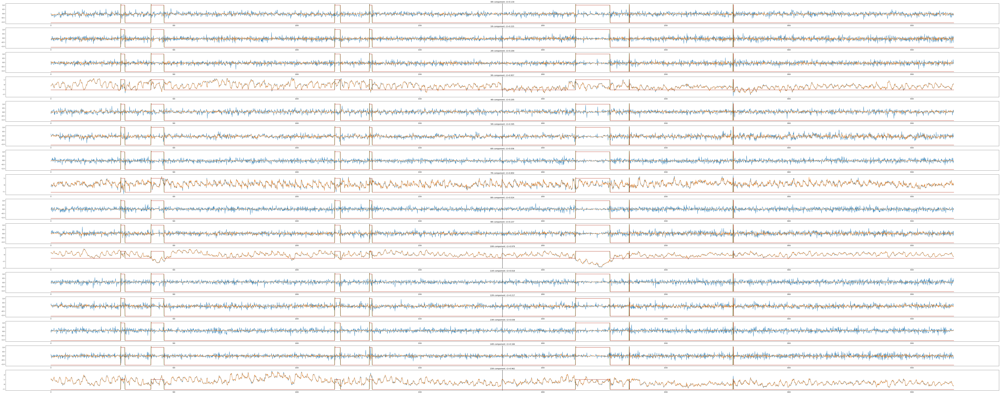

r2_score = 0.347
z_self_corr = 0.041
z_unique_features = 9.810
cpc_pow = 3.407


In [656]:
pred_horizon = 1
_, axs = plt.subplots(z.size(2), 1, figsize=(120, 3 * z.size(2)))
for i, ax in zip(range(z.size(2)), axs):
    ax.plot(z[0, pred_horizon:, i].detach().numpy())
    ax.plot(p[pred_horizon - 1][0, :-pred_horizon, i].detach().numpy())

    ax.axvline(z.size(1) // 2, color='black')
    y_data_reduced.map({'NORMAL': -1.1, 'RECOVERING': 1.0, 'BROKEN': 1.1}).shift(-pred_horizon).plot(ax=ax)
    y_data_reduced.map({'NORMAL': -1.1, 'RECOVERING': 1.0, 'BROKEN': 1.1}).shift(0).plot(ax=ax)
#     ax.set_xlim((1000, 2500))
    r2_score = torch.where(
        z[0, pred_horizon:, i].var() * (z.size(1) - pred_horizon) > 1e-6,
        1 - (z[0, pred_horizon:, i] - p[pred_horizon - 1][0, :-pred_horizon, i]).pow(2).sum() / 
            z[0, pred_horizon:, i].var() / (z.size(1) - pred_horizon),
        torch.tensor([0.0]),
    )
    
    ax.set_title(f'{i}th compoment. r2={r2_score.item():.3f}')
plt.show()

r2_score = torch.where(
    z[:, pred_horizon:, :].var(dim=1) / (z.size(1) - pred_horizon) > 1e-6,
    1 - (z[:, pred_horizon:] - p[pred_horizon - 1][:, :-pred_horizon]).pow(2).sum(dim=1) / 
        z[:, pred_horizon:, :].var(dim=1) / (z.size(1) - pred_horizon),
    torch.tensor([0.0]),
)
print(f'r2_score = {r2_score.mean():.3f}')

_z = (z - z.mean(dim=1, keepdims=True)) / (z.std(dim=1, keepdims=True) + 1e-6)
mc = torch.bmm(_z.transpose(1, 2), _z).abs() / _z.size(1)
C = mc.size(1)
off_diag_ix = (1 - torch.eye(C)).bool().view(-1)
m = mc.view(-1, C * C)[:, off_diag_ix].mean()
print(f'z_self_corr = {m:.3f}')
print(f'z_unique_features = {1 / (mc.mean() + 1e-3):.3f}', )
print(f'cpc_pow = {r2_score.mean() / (mc.mean() + 1e-3):.3f}')

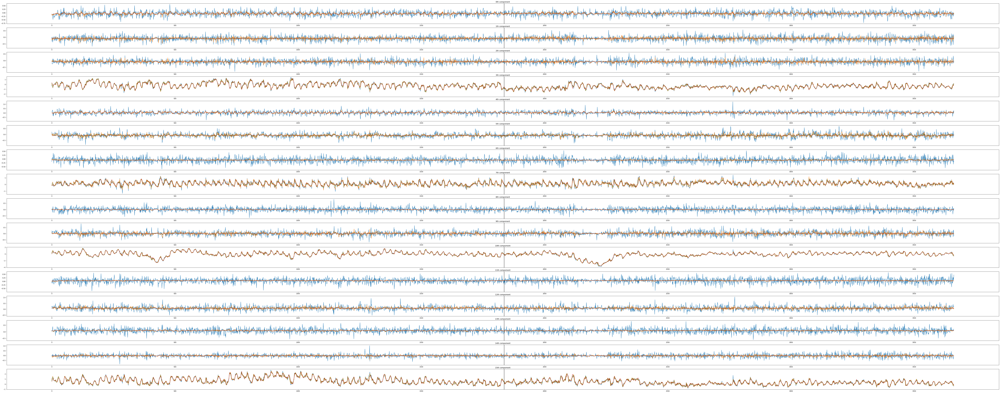

In [657]:
_, axs = plt.subplots(z.size(2), 1, figsize=(120, 3 * z.size(2)))
for i, ax in zip(range(z.size(2)), axs):
    ax.plot(z[0, 10:, i].detach().numpy())
    for pred_horizon in range(1, 4):
        ax.plot(p[pred_horizon - 1][0, 9 - pred_horizon + 1:-pred_horizon, i].detach().numpy())

    ax.axvline(z.size(1) // 2, color='black')
#     ax.set_xlim((1000, 1200))
    ax.set_title(f'{i}th compoment')
plt.show()


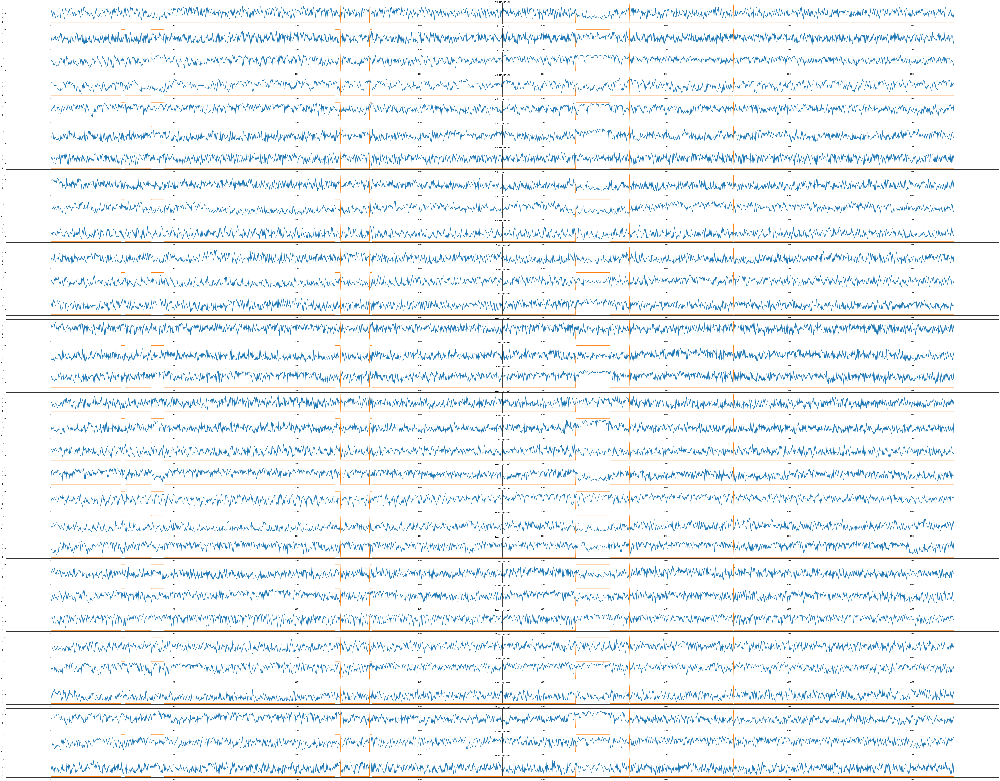

In [702]:
_, axs = plt.subplots(c.size(2), 1, figsize=(120, 3 * c.size(2)))
for i, ax in zip(range(c.size(2)), axs):
    ax.plot(c[0, :, i].detach().numpy())
    ax.axvline(z.size(1) // 2, color='black')
    ax.axvline(z.size(1) // 4, color='black')
    y_data_reduced.map({'NORMAL': -1.1, 'RECOVERING': 1.0, 'BROKEN': 1.1}).shift(0).plot(ax=ax)
    ax.set_title(f'{i}th compoment')
plt.show()


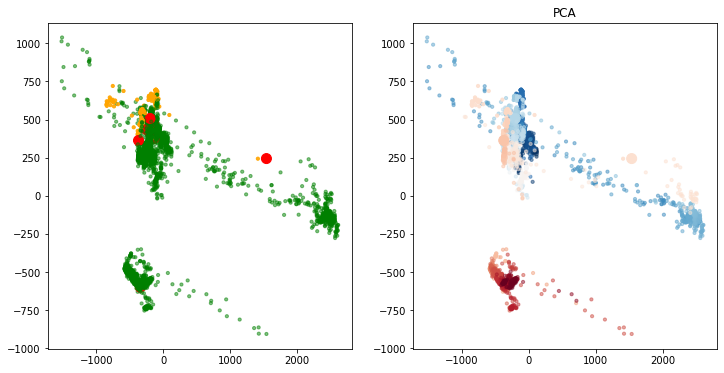

In [659]:
pca = PCA(n_components=2)
r_pca = pca.fit_transform(x_reduced[0].numpy())

_, axs = plt.subplots(1, 2, figsize=(2 * 6, 6))
axs[0].scatter(
    r_pca[:, 0], r_pca[:, 1],
    c=y_data_reduced.map({'NORMAL': 'green', 'RECOVERING': 'orange', 'BROKEN': 'red'}).values,
    s=y_data_reduced.map({'NORMAL': 10, 'RECOVERING': 10, 'BROKEN': 100}).values,
    alpha=y_data_reduced.map({'NORMAL': 0.5, 'RECOVERING': 0.9, 'BROKEN': 1.0}).values,
)
axs[1].scatter(
    r_pca[:, 0], r_pca[:, 1],
    c=[plt.get_cmap('RdBu_r')(i) for i in np.linspace(0, 1, len(y_data_reduced))],
    s=y_data_reduced.map({'NORMAL': 10, 'RECOVERING': 10, 'BROKEN': 100}).values,
    alpha=y_data_reduced.map({'NORMAL': 0.5, 'RECOVERING': 0.9, 'BROKEN': 1.0}).values,
)
plt.title('PCA')
plt.show()

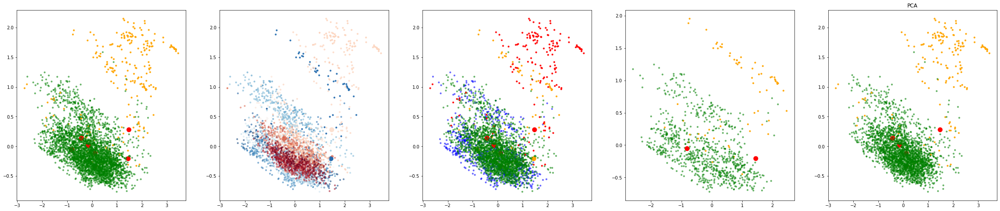

In [713]:
pca = PCA(n_components=2)
r_pca = pca.fit_transform(z[0].numpy())

_, axs = plt.subplots(1, 5, figsize=(5 * 8, 8))
axs[0].scatter(
    r_pca[:, 0], r_pca[:, 1],
    c=y_data_reduced.map({'NORMAL': 'green', 'RECOVERING': 'orange', 'BROKEN': 'red'}).values,
    s=y_data_reduced.map({'NORMAL': 10, 'RECOVERING': 10, 'BROKEN': 100}).values,
    alpha=y_data_reduced.map({'NORMAL': 0.5, 'RECOVERING': 0.9, 'BROKEN': 1.0}).values,
)
axs[1].scatter(
    r_pca[:, 0], r_pca[:, 1],
    c=[plt.get_cmap('RdBu_r')(i) for i in np.linspace(0, 1, len(y_data_reduced))],
    s=y_data_reduced.map({'NORMAL': 10, 'RECOVERING': 10, 'BROKEN': 100}).values,
    alpha=y_data_reduced.map({'NORMAL': 0.5, 'RECOVERING': 0.9, 'BROKEN': 1.0}).values,
)
axs[2].scatter(
    r_pca[:, 0], r_pca[:, 1],
    c=[(('blue' if v == 'NORMAL' else 'orange') if i < c.size(1) // 4 else ('green' if v == 'NORMAL' else 'red')) 
       for i, v in zip(np.arange(c.size(1)), y_data_reduced.values)],
    s=y_data_reduced.map({'NORMAL': 10, 'RECOVERING': 10, 'BROKEN': 100}).values,
    alpha=y_data_reduced.map({'NORMAL': 0.5, 'RECOVERING': 0.9, 'BROKEN': 1.0}).values,
)
axs[3].scatter(
    r_pca[:c.size(1) // 4, 0], r_pca[:c.size(1) // 4, 1],
    c=y_data_reduced.map({'NORMAL': 'green', 'RECOVERING': 'orange', 'BROKEN': 'red'}).values[:c.size(1) // 4],
    s=y_data_reduced.map({'NORMAL': 10, 'RECOVERING': 10, 'BROKEN': 100}).values[:c.size(1) // 4],
    alpha=y_data_reduced.map({'NORMAL': 0.5, 'RECOVERING': 0.9, 'BROKEN': 1.0}).values[:c.size(1) // 4],
)
axs[4].scatter(
    r_pca[c.size(1) // 4:, 0], r_pca[c.size(1) // 4:, 1],
    c=y_data_reduced.map({'NORMAL': 'green', 'RECOVERING': 'orange', 'BROKEN': 'red'}).values[c.size(1) // 4:],
    s=y_data_reduced.map({'NORMAL': 10, 'RECOVERING': 10, 'BROKEN': 100}).values[c.size(1) // 4:],
    alpha=y_data_reduced.map({'NORMAL': 0.5, 'RECOVERING': 0.9, 'BROKEN': 1.0}).values[c.size(1) // 4:],
)
plt.title('PCA')
plt.show()

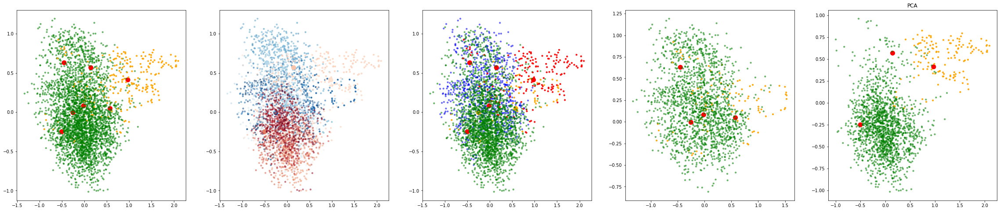

In [711]:
pca = PCA(n_components=2)
r_pca = pca.fit_transform(c[0].numpy())

_, axs = plt.subplots(1, 5, figsize=(5 * 8, 8))
axs[0].scatter(
    r_pca[:, 0], r_pca[:, 1],
    c=y_data_reduced.map({'NORMAL': 'green', 'RECOVERING': 'orange', 'BROKEN': 'red'}).values,
    s=y_data_reduced.map({'NORMAL': 10, 'RECOVERING': 10, 'BROKEN': 100}).values,
    alpha=y_data_reduced.map({'NORMAL': 0.5, 'RECOVERING': 0.9, 'BROKEN': 1.0}).values,
)
axs[1].scatter(
    r_pca[:, 0], r_pca[:, 1],
    c=[plt.get_cmap('RdBu_r')(i) for i in np.linspace(0, 1, len(y_data_reduced))],
    s=y_data_reduced.map({'NORMAL': 10, 'RECOVERING': 10, 'BROKEN': 100}).values,
    alpha=y_data_reduced.map({'NORMAL': 0.5, 'RECOVERING': 0.9, 'BROKEN': 1.0}).values,
)
axs[2].scatter(
    r_pca[:, 0], r_pca[:, 1],
    c=[(('blue' if v == 'NORMAL' else 'orange') if i < c.size(1) // 4 else ('green' if v == 'NORMAL' else 'red')) 
       for i, v in zip(np.arange(c.size(1)), y_data_reduced.values)],
    s=y_data_reduced.map({'NORMAL': 10, 'RECOVERING': 10, 'BROKEN': 100}).values,
    alpha=y_data_reduced.map({'NORMAL': 0.5, 'RECOVERING': 0.9, 'BROKEN': 1.0}).values,
)
axs[3].scatter(
    r_pca[:c.size(1) // 2, 0], r_pca[:c.size(1) // 2, 1],
    c=y_data_reduced.map({'NORMAL': 'green', 'RECOVERING': 'orange', 'BROKEN': 'red'}).values[:c.size(1) // 2],
    s=y_data_reduced.map({'NORMAL': 10, 'RECOVERING': 10, 'BROKEN': 100}).values[:c.size(1) // 2],
    alpha=y_data_reduced.map({'NORMAL': 0.5, 'RECOVERING': 0.9, 'BROKEN': 1.0}).values[:c.size(1) // 2],
)
axs[4].scatter(
    r_pca[c.size(1) // 2:, 0], r_pca[c.size(1) // 2:, 1],
    c=y_data_reduced.map({'NORMAL': 'green', 'RECOVERING': 'orange', 'BROKEN': 'red'}).values[c.size(1) // 2:],
    s=y_data_reduced.map({'NORMAL': 10, 'RECOVERING': 10, 'BROKEN': 100}).values[c.size(1) // 2:],
    alpha=y_data_reduced.map({'NORMAL': 0.5, 'RECOVERING': 0.9, 'BROKEN': 1.0}).values[c.size(1) // 2:],
)
plt.title('PCA')
plt.show()

In [700]:
c.shape

torch.Size([1, 3672, 32])

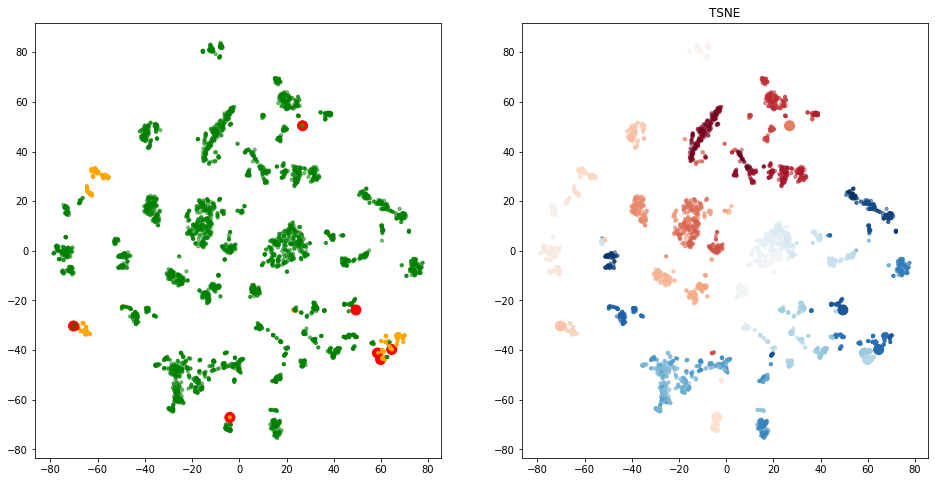

In [662]:
tsne = TSNE(n_components=2)
r_tsne = tsne.fit_transform(x_reduced[0].numpy())

_, axs = plt.subplots(1, 2, figsize=(2 * 8, 8))
axs[0].scatter(
    r_tsne[:, 0], r_tsne[:, 1],
    c=y_data_reduced.map({'NORMAL': 'green', 'RECOVERING': 'orange', 'BROKEN': 'red'}).values,
    s=y_data_reduced.map({'NORMAL': 10, 'RECOVERING': 10, 'BROKEN': 100}).values,
    alpha=y_data_reduced.map({'NORMAL': 0.5, 'RECOVERING': 0.9, 'BROKEN': 1.0}).values,
)
axs[1].scatter(
    r_tsne[:, 0], r_tsne[:, 1],
    c=[plt.get_cmap('RdBu_r')(i) for i in np.linspace(0, 1, len(y_data_reduced))],
    s=y_data_reduced.map({'NORMAL': 10, 'RECOVERING': 10, 'BROKEN': 100}).values,
    alpha=y_data_reduced.map({'NORMAL': 0.5, 'RECOVERING': 0.9, 'BROKEN': 1.0}).values,
)
plt.title('TSNE')
plt.show()

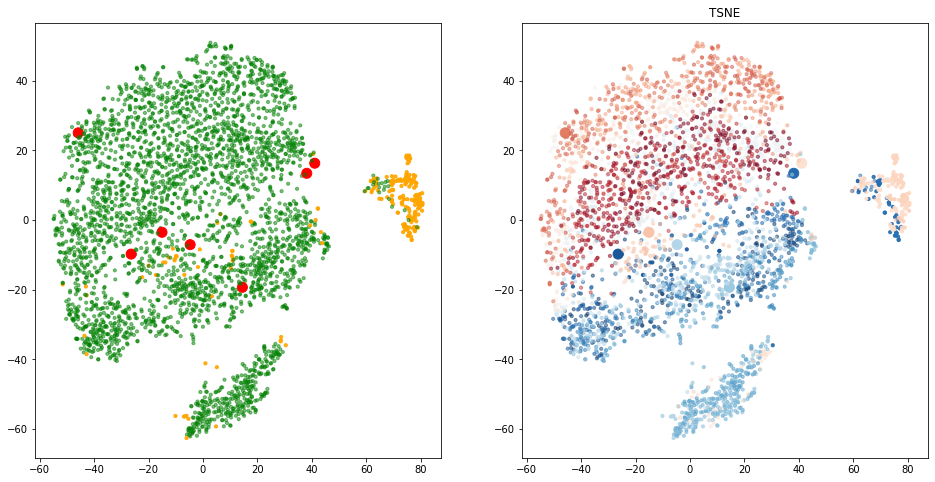

In [663]:
tsne = TSNE(n_components=2)
r_tsne = tsne.fit_transform(z[0].numpy())

_, axs = plt.subplots(1, 2, figsize=(2 * 8, 8))
axs[0].scatter(
    r_tsne[:, 0], r_tsne[:, 1],
    c=y_data_reduced.map({'NORMAL': 'green', 'RECOVERING': 'orange', 'BROKEN': 'red'}).values,
    s=y_data_reduced.map({'NORMAL': 10, 'RECOVERING': 10, 'BROKEN': 100}).values,
    alpha=y_data_reduced.map({'NORMAL': 0.5, 'RECOVERING': 0.9, 'BROKEN': 1.0}).values,
)
axs[1].scatter(
    r_tsne[:, 0], r_tsne[:, 1],
    c=[plt.get_cmap('RdBu_r')(i) for i in np.linspace(0, 1, len(y_data_reduced))],
    s=y_data_reduced.map({'NORMAL': 10, 'RECOVERING': 10, 'BROKEN': 100}).values,
    alpha=y_data_reduced.map({'NORMAL': 0.5, 'RECOVERING': 0.9, 'BROKEN': 1.0}).values,
)
plt.title('TSNE')
plt.show()

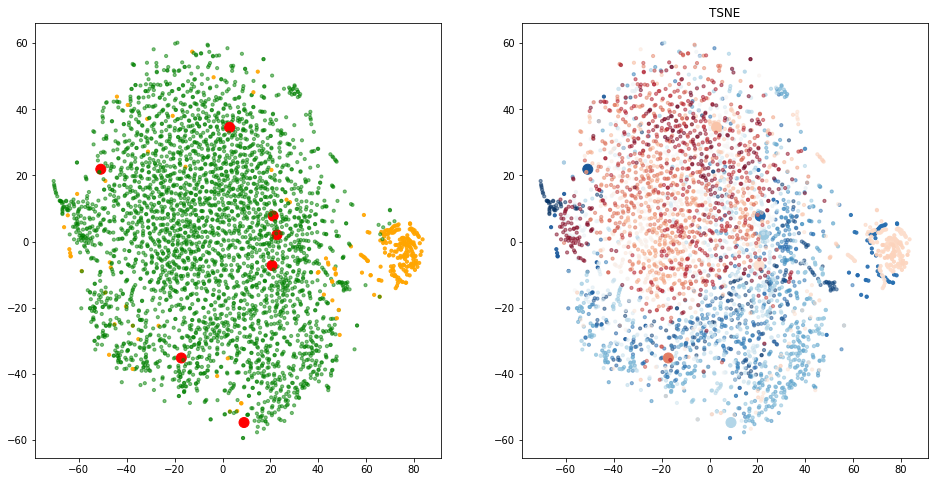

In [664]:
tsne = TSNE(n_components=2)
r_tsne = tsne.fit_transform(c[0].numpy())

_, axs = plt.subplots(1, 2, figsize=(2 * 8, 8))
axs[0].scatter(
    r_tsne[:, 0], r_tsne[:, 1],
    c=y_data_reduced.map({'NORMAL': 'green', 'RECOVERING': 'orange', 'BROKEN': 'red'}).values,
    s=y_data_reduced.map({'NORMAL': 10, 'RECOVERING': 10, 'BROKEN': 100}).values,
    alpha=y_data_reduced.map({'NORMAL': 0.5, 'RECOVERING': 0.9, 'BROKEN': 1.0}).values,
)
axs[1].scatter(
    r_tsne[:, 0], r_tsne[:, 1],
    c=[plt.get_cmap('RdBu_r')(i) for i in np.linspace(0, 1, len(y_data_reduced))],
    s=y_data_reduced.map({'NORMAL': 10, 'RECOVERING': 10, 'BROKEN': 100}).values,
    alpha=y_data_reduced.map({'NORMAL': 0.5, 'RECOVERING': 0.9, 'BROKEN': 1.0}).values,
)
plt.title('TSNE')
plt.show()

In [665]:
ws = 5 * 12 * 1
ws

60

In [715]:
predict_steps = -1
ix_x = (np.arange(0, x_data.shape[0] - ws * stream_encoder.hparams.history_size + 1 - 
                  0 * predict_steps * ws, 60).reshape(-1, 1) + 
        np.arange(ws * stream_encoder.hparams.history_size).reshape(1, -1))
ix_y = (np.arange(0, x_data.shape[0] - ws * stream_encoder.hparams.history_size + 1 - 
                  0 * predict_steps * ws, 60).reshape(-1, 1) + 
        np.arange(predict_steps * ws, 0).reshape(1, -1) + ws * stream_encoder.hparams.history_size)

ix_x, ix_y

(array([[     0,      1,      2, ...,   2397,   2398,   2399],
        [    60,     61,     62, ...,   2457,   2458,   2459],
        [   120,    121,    122, ...,   2517,   2518,   2519],
        ...,
        [217800, 217801, 217802, ..., 220197, 220198, 220199],
        [217860, 217861, 217862, ..., 220257, 220258, 220259],
        [217920, 217921, 217922, ..., 220317, 220318, 220319]]),
 array([[  2340,   2341,   2342, ...,   2397,   2398,   2399],
        [  2400,   2401,   2402, ...,   2457,   2458,   2459],
        [  2460,   2461,   2462, ...,   2517,   2518,   2519],
        ...,
        [220140, 220141, 220142, ..., 220197, 220198, 220199],
        [220200, 220201, 220202, ..., 220257, 220258, 220259],
        [220260, 220261, 220262, ..., 220317, 220318, 220319]]))

In [716]:
x_data.shape, ix_x.shape, ix_y.shape

((220320, 51), (3633, 2400), (3633, 60))

In [717]:
dl_inference = torch.utils.data.DataLoader(
    torch.utils.data.TensorDataset(torch.from_numpy(x_data.values[ix_x]).float()),
    batch_size=100,
    num_workers=0,
)

z = []
c = []
with torch.no_grad():
    for x, in tqdm(dl_inference):
        _z, _c = stream_encoder(x)
        z.append(_z[:, -1, :])
        c.append(_c[:, -1, :])
z = torch.cat(z, dim=0)
c = torch.cat(c, dim=0)

  0%|          | 0/37 [00:00<?, ?it/s]

In [718]:
y_reduced = np.where(
    (y_data.values[ix_y] == 'BROKEN').sum(axis=1), 'BROKEN',
    np.where(
        (y_data.values[ix_y] == 'RECOVERING').sum(axis=1), 'RECOVERING',
        'NORMAL',
    ),  
)

In [719]:
x_normal_ix = np.where(
    (y_data.values[ix_x[:, -ix_x.shape[1]//10:]] == 'BROKEN').sum(axis=1), 0,
    np.where(
        (y_data.values[ix_x[:, -ix_x.shape[1]//10:]] == 'RECOVERING').sum(axis=1), 0,
        1,
    ),  
).astype(bool)

In [720]:
z.shape, c.shape, y_reduced.shape, x_normal_ix.shape

(torch.Size([3633, 16]), torch.Size([3633, 32]), (3633,), (3633,))

In [721]:
train_size = 1000
valid_size =  4000

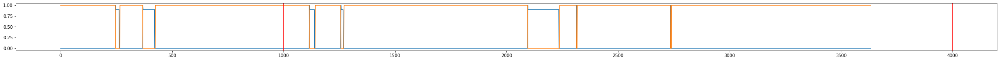

In [677]:
plt.figure(figsize=(40, 2))
plt.plot(
    np.arange(len(y_reduced)),
    [{'NORMAL': 0, 'RECOVERING': 0.9, 'BROKEN': 1}[i] for i in y_reduced],
)
plt.plot(
    np.arange(len(x_normal_ix)),
    x_normal_ix,
)

plt.axvline(train_size, color='red')
plt.axvline(valid_size, color='red')
plt.show()

In [678]:
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_auc_score

In [722]:
for penalty in ['l1', 'l2']:
    for C in [100, 30, 10, 3, 1, 0.3, 0.1, 0.03, 0.01, 0.003, 0.001]:
        model = LogisticRegression(penalty=penalty, C=C, solver='liblinear')
        # solver : {'newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'},             default='lbfgs'

        model.fit(
            z[:train_size],
            (y_reduced != 'NORMAL').astype(int)[:train_size],
        )
        r2s = roc_auc_score(
            (y_reduced != 'NORMAL').astype(int)[train_size:valid_size], 
            model.predict_proba(z[train_size:valid_size])[:, 1],
        )
        print(f'{penalty}  {C:10.6f}, {r2s:.3f}')

l1  100.000000, 0.850
l1   30.000000, 0.850
l1   10.000000, 0.850
l1    3.000000, 0.850
l1    1.000000, 0.846
l1    0.300000, 0.844
l1    0.100000, 0.858
l1    0.030000, 0.900
l1    0.010000, 0.361
l1    0.003000, 0.500
l1    0.001000, 0.500
l2  100.000000, 0.850
l2   30.000000, 0.850
l2   10.000000, 0.850
l2    3.000000, 0.850
l2    1.000000, 0.850
l2    0.300000, 0.849
l2    0.100000, 0.847
l2    0.030000, 0.842
l2    0.010000, 0.807
l2    0.003000, 0.704
l2    0.001000, 0.642


In [729]:
model = LogisticRegression(penalty='l1', C=0.03, solver='liblinear')
model.fit(
    z[:train_size],
    (y_reduced != 'NORMAL').astype(int)[:train_size],
)
roc_auc_score(
    (y_reduced != 'NORMAL').astype(int)[train_size:valid_size], 
    model.predict_proba(z[train_size:valid_size])[:, 1],
)

0.9004743370323341

In [730]:
model.coef_

array([[ 0.        ,  0.        ,  0.        , -0.16414527,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
        -1.0124537 ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ]])

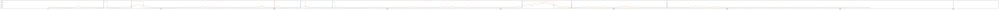

In [728]:
plt.figure(figsize=(240, 2))
for i in np.where(y_reduced == 'BROKEN')[0]:
    plt.axvline(i, color='gray')
plt.plot(
    np.arange(len(y_reduced)),
    [{'NORMAL': 0, 'RECOVERING': 0.9, 'BROKEN': 1}[i] for i in y_reduced],
    alpha=0.5,
)
# plt.plot(
#     np.arange(len(x_normal_ix)),
#     x_normal_ix,
# )
plt.plot(
    np.arange(len(z)),
    model.predict_proba(z)[:, 1],
#     marker='x', markersize=10,
)
plt.axvline(train_size, color='red')
plt.axvline(valid_size, color='red')
plt.show()

In [724]:
for penalty in ['l1', 'l2']:
    for C in [100, 30, 10, 3, 1, 0.3, 0.1, 0.03, 0.01, 0.003, 0.001]:
        model = LogisticRegression(penalty=penalty, C=C, solver='liblinear')
        # solver : {'newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'},             default='lbfgs'

        model.fit(
            c[:train_size],
            (y_reduced != 'NORMAL').astype(int)[:train_size],
        )
        r2s = roc_auc_score(
            (y_reduced != 'NORMAL').astype(int)[train_size:valid_size], 
            model.predict_proba(c[train_size:valid_size])[:, 1],
        )
        print(f'{penalty}  {C:10.6f}, {r2s:.3f}')

l1  100.000000, 0.860
l1   30.000000, 0.861
l1   10.000000, 0.861
l1    3.000000, 0.860
l1    1.000000, 0.859
l1    0.300000, 0.870
l1    0.100000, 0.887
l1    0.030000, 0.763
l1    0.010000, 0.500
l1    0.003000, 0.500
l1    0.001000, 0.500
l2  100.000000, 0.862
l2   30.000000, 0.867
l2   10.000000, 0.872
l2    3.000000, 0.878
l2    1.000000, 0.882
l2    0.300000, 0.886
l2    0.100000, 0.888
l2    0.030000, 0.874
l2    0.010000, 0.787
l2    0.003000, 0.543
l2    0.001000, 0.408


In [686]:
model = LogisticRegression(penalty='l2', C=0.1, solver='liblinear')
# solver : {'newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'},             default='lbfgs'

model.fit(
    c[:train_size],
    (y_reduced != 'NORMAL').astype(int)[:train_size],
)
roc_auc_score(
    (y_reduced != 'NORMAL').astype(int)[train_size:valid_size], 
    model.predict_proba(c[train_size:valid_size])[:, 1],
)

0.8881558365078489

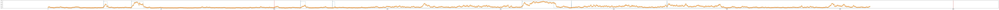

In [687]:
plt.figure(figsize=(240, 2))
for i in np.where(y_reduced == 'BROKEN')[0]:
    plt.axvline(i, color='gray')
plt.plot(
    np.arange(len(y_reduced)),
    [{'NORMAL': 0, 'RECOVERING': 0.9, 'BROKEN': 1}[i] for i in y_reduced],
    alpha=0.5,
)
# plt.plot(
#     np.arange(len(x_normal_ix)),
#     x_normal_ix,
# )
plt.plot(
    np.arange(len(c)),
    model.predict_proba(c)[:, 1],
    marker='x', markersize=10,
)
plt.axvline(train_size, color='red')
plt.axvline(valid_size, color='red')
plt.show()

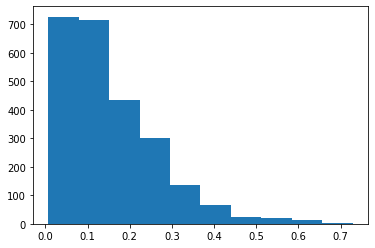

In [688]:
plt.hist(y_predict[x_normal_ix[train_size:valid_size]])

plt.show()

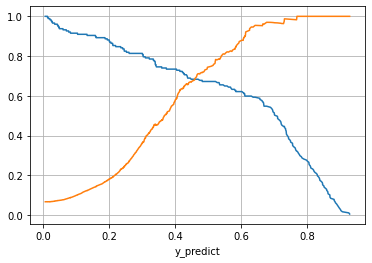

In [692]:
(pd.DataFrame({
    'y_true': (y_reduced != 'NORMAL').astype(int)[train_size:valid_size], 
    'y_predict': model.predict_proba(c)[:, 1][train_size:valid_size],
}).set_index('y_predict').sort_index(ascending=False).cumsum()['y_true'].rename('recall') / 
        (y_reduced != 'NORMAL').astype(int)[train_size:valid_size].sum()).plot()

pd.DataFrame({
    'y_true': (y_reduced != 'NORMAL').astype(int)[train_size:valid_size], 
    'y_predict': model.predict_proba(c)[:, 1][train_size:valid_size],
}).set_index('y_predict').sort_index(ascending=False).assign(k=1).cumsum() \
.assign(precision=lambda x: x['y_true'] / x['k'])['precision'].plot()

plt.grid()
plt.show()
